In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium.features import GeoJsonPopup, GeoJsonTooltip

In [2]:
derechocalls = pd.read_csv('../data/911CallsDerecho.csv')
tornadocalls = pd.read_csv('../data/911CallsTornado.csv')
cadderecho = pd.read_csv('../data/CADDerecho.csv')
cadtornado = pd.read_csv('../data/CADTornado.csv')

In [3]:
derechocalls.head(1)

,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,5/3/2020 21:05,911 Calls,36.129696,-86.844645,4220 HARDING PKE


In [4]:
tornadocalls.head(1)

,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector


In [5]:
cadderecho.head(1)

,IncidentDate,Location,Latitude1,Longitude1,IncidentTypeDescription1
0,5/3/2020 16:31,901 KENWICK CT W,36.046877,-86.962526,ELECTRICAL HAZARD


In [6]:
cadtornado.head(1)

,IncidentDate,Location,Latitude1,Longitude1,IncidentTypeDescription1
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


In [7]:
derechocalls = derechocalls.rename(columns={"Seizure DateTime":"Time","CallTypeId":"ID","ALI Latitude":"lat","ALI Longitude":"lng","Cell Tower Address":"CellTower"})
derechocalls.head(1)

,Time,ID,lat,lng,CellTower
0,5/3/2020 21:05,911 Calls,36.129696,-86.844645,4220 HARDING PKE


In [8]:
derechocalls['geometry'] = derechocalls.apply(lambda x: Point((float(x.lng), 
                                                         float(x.lat))), 
                                        axis=1)
derechocalls

,Time,ID,lat,lng,CellTower,geometry
0,5/3/2020 21:05,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.844645 36.129696)
1,5/3/2020 21:08,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.844645 36.129696)
2,5/3/2020 22:17,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.844645 36.129696)
3,5/3/2020 23:17,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.844645 36.129696)
4,5/3/2020 16:43,911 Calls,35.900295,-86.493559,WIRELESS 911 CALLER,POINT (-86.493559 35.900295)
...,...,...,...,...,...,...
1510,5/3/2020 21:10,911 Calls,36.013377,-87.043583,8621C HASELTON RD - W,POINT (-87.043583 36.013377)
1511,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05632900000001 36.100516)
1512,5/3/2020 20:12,911 Calls,36.115741,-87.098494,1832 HIGHWAY 70 - SE,POINT (-87.098494 36.115741)
1513,5/3/2020 19:23,911 Calls,36.489222,-87.209923,WIRELESS CALL,POINT (-87.209923 36.489222)


In [9]:
mapderecho = folium.Map(zoom_start = 12)

In [10]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')

In [11]:
derechocallsgeo = gpd.GeoDataFrame(derechocalls, crs = zipcodes.crs, geometry = derechocalls.geometry)
type(derechocallsgeo)

geopandas.geodataframe.GeoDataFrame

In [12]:
derechocallsbyzip = gpd.sjoin(derechocallsgeo, zipcodes, op = 'within')
derechocallsbyzip.head(1)

,Time,ID,lat,lng,CellTower,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
0,5/3/2020 21:05,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.84464 36.12970),39,37205,16,NASHVILLE,146801.80831498865,400978073.00933838


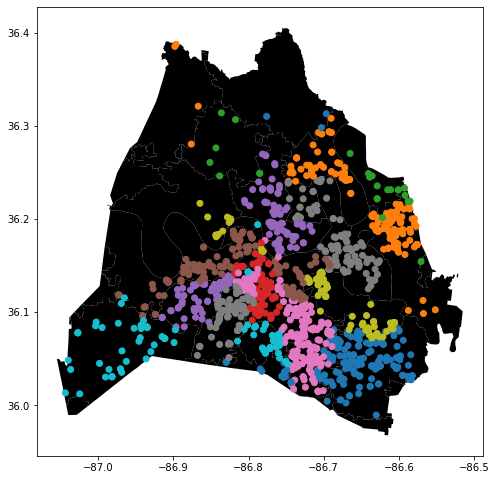

In [13]:
ax = zipcodes.plot(figsize = (8,10), color = 'black')
derechocallsbyzip.plot(ax = ax, column = 'zip')
plt.show()

In [14]:
derechocallsbyzip.zip.value_counts()

37013    194
37211    194
37076    125
37205    106
37214     90
37215     75
37217     74
37209     72
37204     58
37207     56
37115     52
37210     51
37221     44
37220     39
37212     39
37203     34
37206     30
37208     29
37027     20
37216     20
37138     18
37218     11
37189      7
37080      4
37219      3
37072      3
37232      3
37213      2
37228      1
37122      1
37201      1
Name: zip, dtype: int64

In [15]:
derechocalls.Time = derechocalls.Time.astype("datetime64")
derechocalls

,Time,ID,lat,lng,CellTower,geometry
0,2020-05-03 21:05:00,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.84464 36.12970)
1,2020-05-03 21:08:00,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.84464 36.12970)
2,2020-05-03 22:17:00,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.84464 36.12970)
3,2020-05-03 23:17:00,911 Calls,36.129696,-86.844645,4220 HARDING PKE,POINT (-86.84464 36.12970)
4,2020-05-03 16:43:00,911 Calls,35.900295,-86.493559,WIRELESS 911 CALLER,POINT (-86.49356 35.90029)
...,...,...,...,...,...,...
1510,2020-05-03 21:10:00,911 Calls,36.013377,-87.043583,8621C HASELTON RD - W,POINT (-87.04358 36.01338)
1511,2020-05-03 16:30:00,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05633 36.10052)
1512,2020-05-03 20:12:00,911 Calls,36.115741,-87.098494,1832 HIGHWAY 70 - SE,POINT (-87.09849 36.11574)
1513,2020-05-03 19:23:00,911 Calls,36.489222,-87.209923,WIRELESS CALL,POINT (-87.20992 36.48922)


<AxesSubplot:xlabel='Time'>

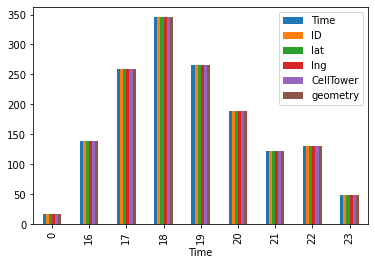

In [16]:
derechocalls.groupby(derechocalls.Time.dt.hour).count().plot(kind="bar")

<AxesSubplot:>

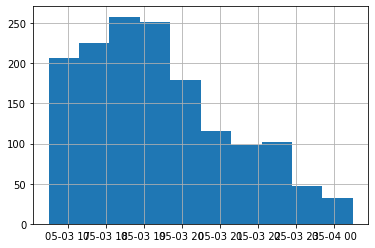

In [17]:
derechocalls.Time.hist()

<AxesSubplot:>

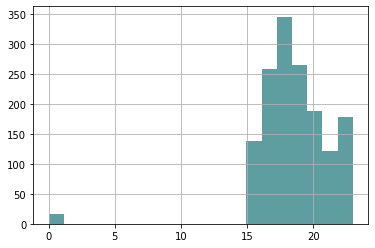

In [18]:
derechocalls.Time.dt.hour.hist(bins = 20, color = 'cadetblue')

In [19]:
derechocalls.Time.dt.hour.value_counts()

18    346
19    265
17    259
20    189
16    138
22    131
21    122
23     48
0      17
Name: Time, dtype: int64

In [20]:
derechofirstcall = derechocalls.sort_values(by=['Time']).head(1)
derechofirstcall

,Time,ID,lat,lng,CellTower,geometry
1511,2020-05-03 16:30:00,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05633 36.10052)


In [21]:
derecholastcall = derechocalls.sort_values(by=['Time']).tail(1)
derecholastcall

,Time,ID,lat,lng,CellTower,geometry
1198,2020-05-04 00:29:00,911 Calls,35.914519,-86.816625,2014 QUAIL HOLLOW CIR,POINT (-86.81663 35.91452)


In [22]:
derechofirstlast = pd.concat([derechofirstcall, derecholastcall])
derechofirstlast

,Time,ID,lat,lng,CellTower,geometry
1511,2020-05-03 16:30:00,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05633 36.10052)
1198,2020-05-04 00:29:00,911 Calls,35.914519,-86.816625,2014 QUAIL HOLLOW CIR,POINT (-86.81663 35.91452)


In [23]:
folium.GeoJson(zipcodes).add_to(mapderecho)
for row_index, row_values in derechofirstlast.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['Time'])
    icon=folium.Icon(color="cadetblue",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(mapderecho)
mapderecho

In [24]:
derechocalls.Time.loc[derechocalls.Time.dt.hour == 18]

13     2020-05-03 18:22:00
17     2020-05-03 18:09:00
18     2020-05-03 18:36:00
26     2020-05-03 18:55:00
27     2020-05-03 18:29:00
               ...        
1492   2020-05-03 18:57:00
1495   2020-05-03 18:20:00
1496   2020-05-03 18:47:00
1498   2020-05-03 18:49:00
1505   2020-05-03 18:05:00
Name: Time, Length: 346, dtype: datetime64[ns]

In [25]:
derechodamage = derechocalls

In [26]:
derechodamage18 = derechodamage.loc[derechocalls.Time.dt.hour == 18]
derechodamage18

,Time,ID,lat,lng,CellTower,geometry
13,2020-05-03 18:22:00,911 Calls,36.188890,-86.567073,WIRELESS CALLER,POINT (-86.56707 36.18889)
17,2020-05-03 18:09:00,911 Calls,36.154386,-86.570678,4316 CENTRAL PIKE - SE,POINT (-86.57068 36.15439)
18,2020-05-03 18:36:00,911 Calls,36.224810,-86.575806,4982 LEESA ANN LA - SECTOR N,POINT (-86.57581 36.22481)
26,2020-05-03 18:55:00,911 Calls,36.172496,-86.576128,4316 CENTRAL PIKE - SW,POINT (-86.57613 36.17250)
27,2020-05-03 18:29:00,911 Calls,36.192216,-86.577308,13895 F LEBANON RD - SW,POINT (-86.57731 36.19222)
...,...,...,...,...,...,...
1492,2020-05-03 18:57:00,911 Calls,36.266052,-86.983931,1939 HIGHWAY 12 SOUTH - E,POINT (-86.98393 36.26605)
1495,2020-05-03 18:20:00,911 Calls,36.083533,-86.994724,9005 NEWSOM STATION RD - SECTOR NE,POINT (-86.99472 36.08353)
1496,2020-05-03 18:47:00,911 Calls,36.044995,-86.998093,8013 C MCCRORY LN - SE,POINT (-86.99809 36.04500)
1498,2020-05-03 18:49:00,911 Calls,36.085378,-87.003329,9005 NEWSOM STATION RD - N,POINT (-87.00333 36.08538)


In [27]:
for row_index, row_values in derechodamage18.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['Time'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(mapderecho)
mapderecho

In [28]:
tornadocalls.head(1)

,Seizure DateTime,CallTypeId,ALI Latitude,ALI Longitude,Cell Tower Address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector


In [29]:
tornadocalls = tornadocalls.rename(columns = {"Seizure DateTime":"Time","CallTypeId":"ID","ALI Latitude":"lat","ALI Longitude":"lng","Cell Tower Address":"CellTower"})

In [30]:
tornadocalls.Time = tornadocalls.Time.astype("datetime64")
tornadocalls

,Time,ID,lat,lng,CellTower
0,2020-03-03 00:34:00,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,2020-03-03 00:36:00,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,2020-03-03 00:36:00,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,2020-03-03 00:36:00,911 Calls,36.156970,-86.880736,526 FOUNDRY DR
4,2020-03-03 00:36:00,911 Calls,36.178839,-86.692286,5007B RUSKIN AVE - N
...,...,...,...,...,...
463,2020-03-03 04:54:00,911 Calls,36.142552,-86.635330,WIRELESS CALLER
464,2020-03-03 04:54:00,911 Calls,36.189415,-86.813557,WIRELESS CALLER
465,2020-03-03 04:55:00,911 Calls,36.223534,-86.757874,WIRELESS CALLER
466,2020-03-03 04:56:00,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE


In [31]:
tornadocalls.Time.dt.hour.value_counts()

1    191
0     94
2     88
3     48
4     47
Name: Time, dtype: int64

In [32]:
tornadocalls.sort_values(by=['Time'])

,Time,ID,lat,lng,CellTower
0,2020-03-03 00:34:00,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,2020-03-03 00:36:00,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,2020-03-03 00:36:00,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,2020-03-03 00:36:00,911 Calls,36.156970,-86.880736,526 FOUNDRY DR
4,2020-03-03 00:36:00,911 Calls,36.178839,-86.692286,5007B RUSKIN AVE - N
...,...,...,...,...,...
463,2020-03-03 04:54:00,911 Calls,36.142552,-86.635330,WIRELESS CALLER
464,2020-03-03 04:54:00,911 Calls,36.189415,-86.813557,WIRELESS CALLER
465,2020-03-03 04:55:00,911 Calls,36.223534,-86.757874,WIRELESS CALLER
466,2020-03-03 04:56:00,911 Calls,36.168398,-86.783774,600 DR MARTIN L KING JR BLVD - NE


In [33]:
tornadodamage1 = tornadocalls.loc[tornadocalls.Time.dt.hour == 1]
tornadodamage1

,Time,ID,lat,lng,CellTower
94,2020-03-03 01:00:00,911 Calls,36.189212,-86.757231,859 GRANADA AVE - S
95,2020-03-03 01:00:00,911 Calls,36.169825,-86.812956,2101 E HEIMAN ST - N
96,2020-03-03 01:00:00,911 Calls,36.186989,-86.628052,3333 LEBANON PIKE - SE
97,2020-03-03 01:00:00,911 Calls,36.175350,-86.804756,1409 JEFFERSON ST - N SECTOR
98,2020-03-03 01:00:00,911 Calls,36.194843,-86.729057,2002 CAHAL AVE - SE
...,...,...,...,...,...
280,2020-03-03 01:59:00,911 Calls,36.248628,-86.730623,105 W WEBSTER ST - SW
281,2020-03-03 01:59:00,911 Calls,36.174747,-86.669212,2817 LEALTO CT - SECTOR SE
282,2020-03-03 01:59:00,911 Calls,36.175480,-86.726227,2004 CAHAL AVE - S Sector
283,2020-03-03 01:59:00,911 Calls,36.175715,-86.757338,861C GRANADA AV - S


In [34]:
countycenter = [36.166,-86.78]
tornadomap = folium.Map(location = countycenter, zoom_start = 12)

In [35]:
folium.GeoJson(zipcodes).add_to(tornadomap)
for row_index, row_values in tornadodamage1.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['Time'])
    icon=folium.Icon(color="green",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(tornadomap)
tornadomap

In [36]:
pathspolygon = gpd.read_file('../data/path_polygons.geojson')
damagepoints = gpd.read_file('../data/damage_points.geojson')
tornadopaths = gpd.read_file('../data/tornado_paths.geojson')

In [37]:
marker_cluster = MarkerCluster().add_to(tornadomap)

In [38]:
for row_index, row_values in damagepoints.iterrows():
    loc = [row_values['lat'], row_values['lon']]
    pop = str(row_values['dod_txt'])
    icon=folium.Icon(color="red",icon="exclamation", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(marker_cluster)
tornadomap

In [39]:
tornadopaths = tornadopaths.loc[tornadopaths.event_id == 'Nashville']

In [40]:
tornadopaths.columns

Index(['objectid', 'event_id', 'stormdate', 'starttime', 'endtime', 'startlat',
       'startlon', 'endlat', 'endlon', 'length', 'width', 'injuries',
       'fatalities', 'efscale', 'efnum', 'qc', 'maxwind', 'globalid',
       'cropdamage', 'propdamage', 'edit_user', 'edit_time', 'created_user',
       'created_date', 'last_edited_user', 'last_edited_date', 'comments',
       'Shape__Length', 'geometry'],
      dtype='object')

In [43]:
for row_index, row_values in tornadopaths.iterrows():
    loc = [row_values['startlat'], row_values['startlon']]
    pop = str(row_values['event_id'])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(tornadomap)
for row_index, row_values in tornadopaths.iterrows():
    loc = [row_values['endlat'], row_values['endlon']]
    pop = str(row_values['event_id'])
    icon=folium.Icon(color="red",icon="bolt", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon)
    
    marker.add_to(tornadomap)

In [44]:
tornadomap